In [1]:
import brainpy.math as bm
from canns.models.basic import CANN1D
from canns.task.tracking import SmoothTracking1D
from canns.analyzer.plotting import (
    PlotConfigs,
    energy_landscape_1d_static,
    energy_landscape_1d_animation,
    raster_plot,
    average_firing_rate_plot,
    tuning_curve,
)

# Setup environment
bm.set_dt(0.1)

# Create model
model = CANN1D(num=256, tau=1.0, k=8.1, a=0.5, A=10, J0=4.0)

# Create smooth tracking task
# Stimulus moves from -2.0 to 2.0, then to -1.0
task = SmoothTracking1D(
    cann_instance=model,
    Iext=[-4.0, 4.0, -2.0, 2.0],      # Keypoint positions
    duration=[20.0, 30.0, 20.0], # Duration for each segment
    time_step=bm.get_dt(),
)

# Get task data
task.get_data()

# Define simulation step
def run_step(t, inp):
    model.update(inp)
    return model.u.value, model.r.value, model.inp.value

# Run simulation
u_history, r_history, input_history = bm.for_loop(run_step, operands=(task.run_steps, task.data), progress_bar=10)

<SmoothTracking1D> Generating Task data: 700it [00:00, 1633.05it/s]


  0%|          | 0/700 [00:00<?, ?it/s]

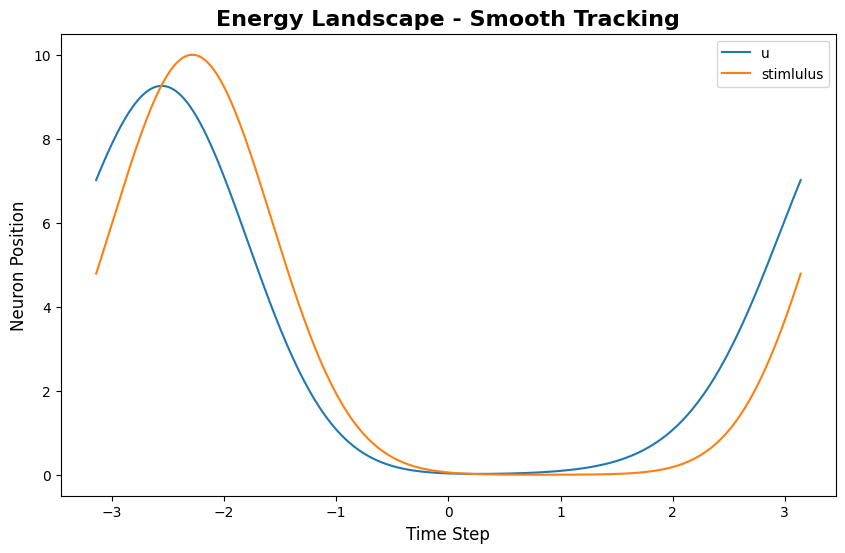

(<Figure size 1000x600 with 1 Axes>,
 <Axes: title={'center': 'Energy Landscape - Smooth Tracking'}, xlabel='Time Step', ylabel='Neuron Position'>)

In [2]:
index = 200 # Time step to visualize

# Configure static energy landscape
config_static = PlotConfigs.energy_landscape_1d_static(
    figsize=(10, 6),
    title='Energy Landscape - Smooth Tracking',
    xlabel='Time Step',
    ylabel='Neuron Position',
    show=True,
    save_path=None
)

# Plot static energy landscape
energy_landscape_1d_static(
    data_sets={'u': (model.x, u_history[index]), 'stimlulus': (model.x, input_history[index])},
    config=config_static
)

In [3]:
# Configure animation
config_anim = PlotConfigs.energy_landscape_1d_animation(
    time_steps_per_second=100,  # 100 time steps = 1 second of real time
    fps=20,                      # 20 frames per second
    title='Energy Landscape Animation',
    xlabel='Neuron Position',
    ylabel='Firing Rate',
    repeat=True,
    show=True,
    save_path=None  # Set to 'animation.gif' to save
)

# Generate animation
energy_landscape_1d_animation(
    data_sets={'u': (model.x, u_history), 'stimlulus': (model.x, input_history)},
    config=config_anim
)

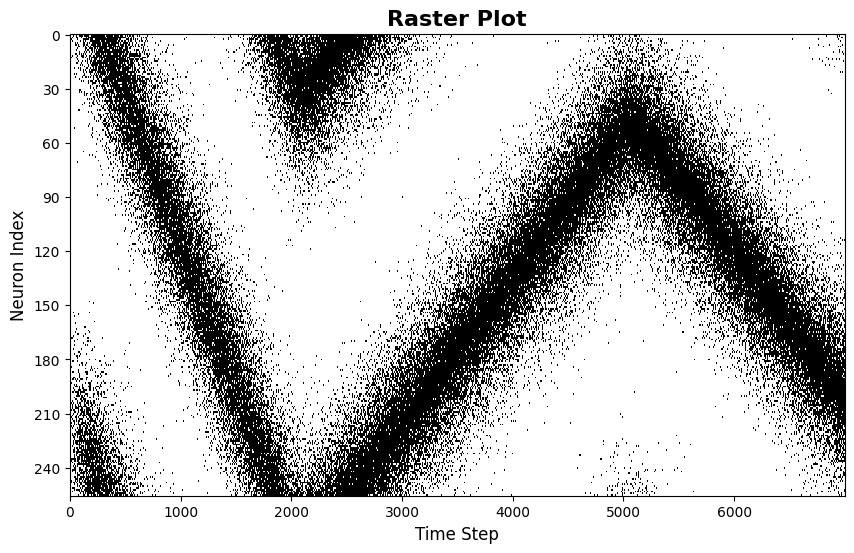

(<Figure size 1000x600 with 1 Axes>,
 <Axes: title={'center': 'Raster Plot'}, xlabel='Time Step', ylabel='Neuron Index'>)

In [4]:
from canns.analyzer.utils import firing_rate_to_spike_train

# Configure raster plot
config_raster = PlotConfigs.raster_plot(
    figsize=(10, 6),
    title='Raster Plot',
    xlabel='Time Step',
    ylabel='Neuron Index',
    show=True,
    save_path=None
)

# use u to generate spike train, because it has higher values
spike_train = firing_rate_to_spike_train(u_history, dt_spike=0.01, dt_rate=bm.get_dt())

# Plot raster
raster_plot(
    spike_train=spike_train,
    config=config_raster
)

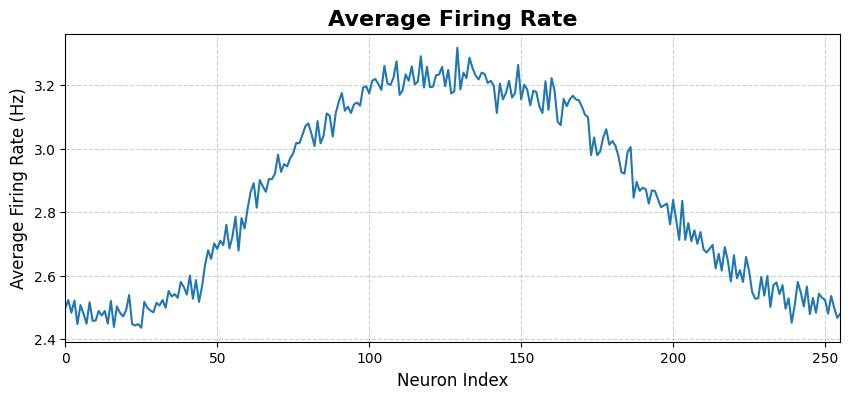

(<Figure size 1000x400 with 1 Axes>,
 <Axes: title={'center': 'Average Firing Rate'}, xlabel='Neuron Index', ylabel='Average Firing Rate (Hz)'>)

In [5]:
# Configure average firing rate plot
config_avg = PlotConfigs.average_firing_rate_plot(
    figsize=(10, 4),
    title='Average Firing Rate',
    xlabel='Time (ms)',
    ylabel='Average Firing Rate',
    show=True,
    save_path=None
)

# Plot average firing rate
average_firing_rate_plot(
    spike_train=spike_train,
    dt=bm.get_dt(),
    config=config_avg
)

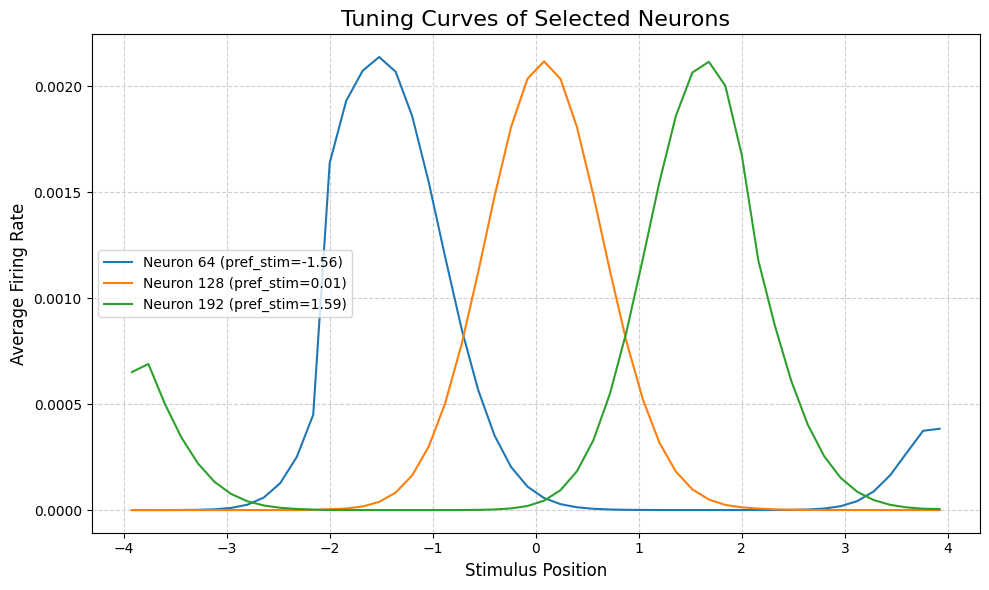

(<Figure size 1000x600 with 1 Axes>,
 <Axes: title={'center': 'Tuning Curves of Selected Neurons'}, xlabel='Stimulus Position', ylabel='Average Firing Rate'>)

In [6]:
# Configure tuning curve
config_tuning = PlotConfigs.tuning_curve(
    num_bins=50,          # Number of position bins
    pref_stim=model.x,    # Preferred stimuli for each neuron
    title='Tuning Curves of Selected Neurons',
    xlabel='Stimulus Position',
    ylabel='Average Firing Rate',
    show=True,
    save_path=None,
)

# Select neurons to plot
neuron_indices = [64, 128, 192]  # Left, center, right

# Plot tuning curves
tuning_curve(
    stimulus=task.Iext_sequence.squeeze(),
    firing_rates=r_history,
    neuron_indices=neuron_indices,
    config=config_tuning
)

In [7]:
from canns.task.tracking import PopulationCoding1D

model = CANN1D(num=256, tau=1.0, k=8.1, a=0.5, A=10, J0=4.0)

# Population coding task
task_pc = PopulationCoding1D(
    cann_instance=model,
    before_duration=10.0,
    after_duration=10.0,
    Iext=0.0,
    duration=20.0,
    time_step=bm.get_dt(),
)

# Get data and run simulation
task_pc.get_data()

u_pc, r_pc, inp_pc = bm.for_loop(run_step, operands=(task_pc.run_steps, task_pc.data), progress_bar=10)

# Visualize
config_anim = PlotConfigs.energy_landscape_1d_animation(
    time_steps_per_second=100,  # 100 time steps = 1 second of real time
    fps=20,                      # 20 frames per second
    title='Energy Landscape Animation - Population Coding',
    xlabel='Neuron Position',
    ylabel='Firing Rate',
    repeat=True,
    show=True,
    save_path=None  # Set to 'animation.gif' to save
)

# Generate animation
energy_landscape_1d_animation(
    data_sets={'u': (model.x, u_pc), 'stimlulus': (model.x, inp_pc)},
    config=config_anim
)

<PopulationCoding1D>Generating Task data(No For Loop)


  0%|          | 0/400 [00:00<?, ?it/s]

In [8]:
from canns.task.tracking import TemplateMatching1D

model = CANN1D(num=256, tau=1.0, k=8.1, a=0.5, A=10, J0=4.0)


# Template matching task
task_tm = TemplateMatching1D(
    cann_instance=model,
    Iext=1.0,
    duration=50.0,
    time_step=bm.get_dt(),
)

# Get data and run simulation
task_tm.get_data()

u_tm, r_tm, inp_tm = bm.for_loop(run_step, operands=(task_tm.run_steps, task_tm.data), progress_bar=10)

# Visualize
config_anim = PlotConfigs.energy_landscape_1d_animation(
    time_steps_per_second=100,  # 100 time steps = 1 second of real time
    fps=20,                      # 20 frames per second
    title='Energy Landscape Animation - Template Matching',
    xlabel='Neuron Position',
    ylabel='Firing Rate',
    repeat=True,
    show=True,
    save_path=None  # Set to 'animation.gif' to save
)

# Generate animation
energy_landscape_1d_animation(
    data_sets={'u': (model.x, u_tm), 'stimlulus': (model.x, inp_tm)},
    config=config_anim
)

<TemplateMatching1D>Generating Task data: 100%|██████████| 500/500 [00:00<00:00, 10877.85it/s]


  0%|          | 0/500 [00:00<?, ?it/s]

In [9]:
from canns.task.tracking import SmoothTracking1D

model = CANN1D(num=256, tau=1.0, k=8.1, a=0.5, A=10, J0=4.0)


# Smooth tracking task
task_st = SmoothTracking1D(
    cann_instance=model,
    Iext=[-2.0, 2.0],
    duration=[50.0],
    time_step=bm.get_dt(),
)

# Get data and run simulation
task_st.get_data()

u_st, r_st, inp_st = bm.for_loop(run_step, operands=(task_st.run_steps, task_st.data), progress_bar=10)

# Visualize
config_anim = PlotConfigs.energy_landscape_1d_animation(
    time_steps_per_second=100,  # 100 time steps = 1 second of real time
    fps=20,                      # 20 frames per second
    title='Energy Landscape Animation - Smooth Tracking',
    xlabel='Neuron Position',
    ylabel='Firing Rate',
    repeat=True,
    show=True,
    save_path=None  # Set to 'animation.gif' to save
)

# Generate animation
energy_landscape_1d_animation(
    data_sets={'u': (model.x, u_st), 'stimlulus': (model.x, inp_st)},
    config=config_anim
)

<SmoothTracking1D> Generating Task data: 500it [00:00, 6982.24it/s]


  0%|          | 0/500 [00:00<?, ?it/s]

In [ ]:
from canns.models.basic import CANN2D
from canns.task.tracking import SmoothTracking2D
from canns.analyzer.plotting import (
    PlotConfigs,
    energy_landscape_2d_static,
    energy_landscape_2d_animation,
)

# Create 2D model
model_2d = CANN2D(
    length=32,      # 32x32 neuron grid
    tau=1.0,
    k=8.1,
    a=0.3,
    A=10,
    J0=4.0,
)

# Create 2D tracking task
# Move from (-1, -1) to (1, 1) to (-1, 1)
task_2d = SmoothTracking2D(
    cann_instance=model_2d,
    Iext=[(-1.0, -1.0), (1.0, 1.0), (-1.0, 1.0)],
    duration=[30.0, 30.0],
    time_step=0.1,
)

# Get data and run simulation
task_2d.get_data()

def run_step_2d(t, inp):
    model_2d.update(inp)
    return model_2d.u.value, model_2d.r.value

u_history_2d, r_history_2d = bm.for_loop(run_step_2d, operands=(task_2d.run_steps, task_2d.data), progress_bar=10)

<SmoothTracking2D> Generating Task data: 600it [00:00, 1153.29it/s]


  0%|          | 0/600 [00:00<?, ?it/s]

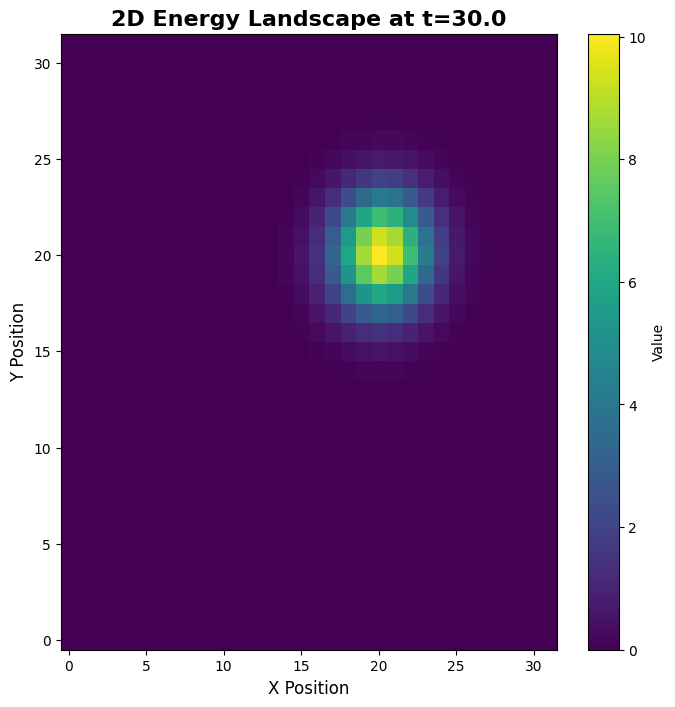

(<Figure size 800x800 with 2 Axes>,
 <Axes: title={'center': '2D Energy Landscape at t=30.0'}, xlabel='X Position', ylabel='Y Position'>)

In [11]:
# Select a time point to visualize
time_idx = 300

# Configure 2D static landscape
config_2d_static = PlotConfigs.energy_landscape_2d_static(
    figsize=(8, 8),
    title=f'2D Energy Landscape at t={time_idx * 0.1:.1f}',
    xlabel='X Position',
    ylabel='Y Position',
    show=True,
    save_path=None
)

# Plot 2D energy landscape at specific time
energy_landscape_2d_static(
    z_data=u_history_2d[time_idx],
    config=config_2d_static
)

In [12]:
# Configure 2D animation
config_2d_anim = PlotConfigs.energy_landscape_2d_animation(
    time_steps_per_second=100,
    fps=20,
    figsize=(8, 8),
    title='2D Energy Landscape Animation',
    xlabel='X Position',
    ylabel='Y Position',
    repeat=True,
    show=True,
    save_path=None  # Set to 'animation_2d.gif' to save
)

# Generate 2D energy landscape animation
energy_landscape_2d_animation(
    zs_data=u_history_2d,
    config=config_2d_anim
)